<div style="display:block;width:100%;margin:auto;" direction=rtl align=center><br><br>
    <div  style="width:100%;margin:100;display:block;background-color:#fff0;"  display=block align=center>
        <table style="border-style:hidden;border-collapse:collapse;">             <tr>
                <td  style="border: none!important;">
                    <img width=130 align=right src="https://i.ibb.co/yXKQmtZ/logo1.png" style="margin:0;" />
                </td>
                <td style="text-align:center;border: none!important;">
                    <h1 align=center><font size=5 color="#045F5F"> <b>Armin Ghasemi</b><br><br>810100198</i></font></h1>
                </td>
                <td style="text-align:center;border: none!important;">
                    <h1 align=center><font size=5 color="#045F5F"> <b> computer vision </b><br><br>HW_3</i></font></h1>
                </td>
                <td style="text-align:center;border: none!important;">
                    <h1 align=center><font size=5 color="#045F5F"> <b>  </b><br><br></i></font></h1>
                </td>
                <td style="border: none!important;">
                    <img width=170 align=left  src="https://i.ibb.co/wLjqFkw/logo2.png" style="margin:0;" />
                </td>
           </tr>
        </table>
    </div>
</div>


## 0. Setup and Installation

In [ ]:
!pip install -q torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
!pip install -q timm segment-anything ultralytics
!pip install -q pillow matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 15.0 MB/s eta 0:00:00


# Import Required Libraries

In [ ]:
import torch
import torchvision
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
from ultralytics import YOLO
import timm
from torchvision.models.segmentation import deeplabv3_resnet50
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights
import matplotlib.image as mpimg

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Using device: cpu


## 1. Show All Input Images
<span style="color:red">
Plot all the images in a single figure.
</span>

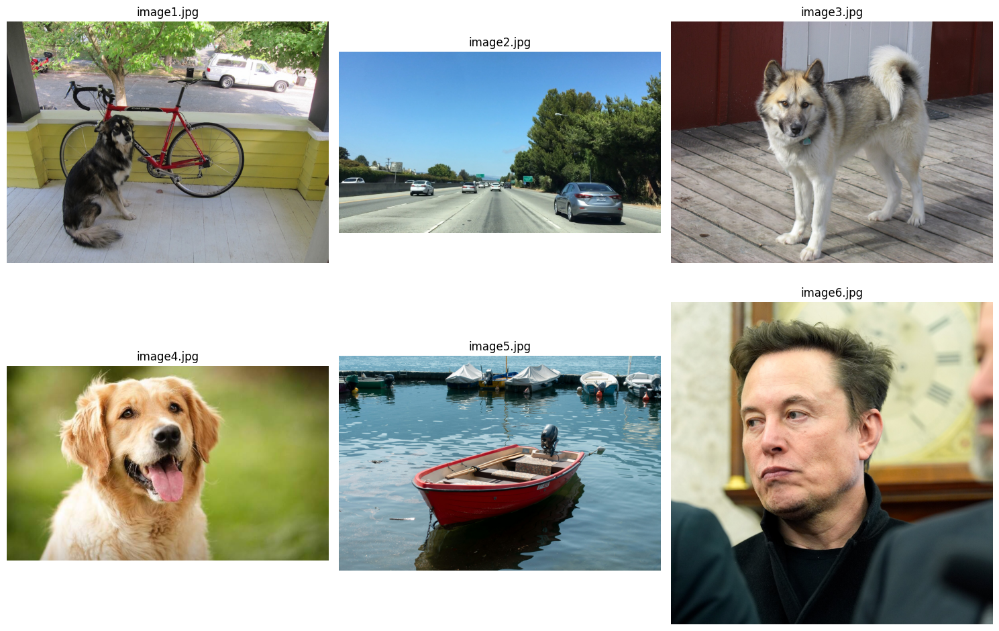

In [3]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# --- Modified Path ---
folder_path = 'assets/inputs/'
# ---------------------

fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

for i in range(6):
    file_name = f'image{i+1}.jpg'
    full_path = os.path.join(folder_path, file_name)

    if os.path.exists(full_path):
        img = mpimg.imread(full_path)
        axes[i].imshow(img)
        axes[i].set_title(file_name)
        axes[i].axis('off')
    else:
        print(f"File not found: {full_path}")
        axes[i].text(0.5, 0.5, 'Not Found', ha='center')
        axes[i].axis('off')

plt.tight_layout()
plt.show()

---
## 2. Task 1 – Image Classification
---
## Model and Dataset Description

For this task, we utilize the **EfficientNet-B4** model. This architecture is part of the EfficientNet family, which introduces a "compound scaling" method. Unlike traditional models that only scale one dimension (like depth), EfficientNet-B4 uniformly scales the network's width, depth, and resolution to achieve high accuracy with better efficiency.

The model is pretrained on the **ImageNet** dataset. This is a large-scale hierarchical image database containing over **1.2 million images** across **1000 different classes** (such as animals, vehicles, and household objects). Using these pretrained weights allows the model to leverage learned features for effective classification.

## Preprocessing Pipeline
In this task, we implement a complete **12-step preprocessing pipeline** to prepare the input images. While these steps—especially augmentation techniques—are primarily used during the training phase to improve model robustness, we apply them here to visualize the transformation process and understand data preparation.

### The 12 Steps:
1.  Convert to NumPy
2.  Gaussian Blur
3.  Unsharp Masking
4.  CLAHE
5.  Convert back to PIL
6.  Padding
7.  Resize
8.  Random Rotation & Crop
9.  Color Jitter & Grayscale
10. To Tensor
11. Normalize
12. Add Batch Dimension

### Detailed Explanation:

1.  **Convert to NumPy:** We convert the image to a NumPy array to enable processing with the OpenCV library.
2.  **Gaussian Blur:** This filter smooths the image to reduce high-frequency noise and grain.
3.  **Unsharp Masking:** We sharpen the image to enhance edges and structural details that might have been softened by the blur.
4.  **CLAHE:** "Contrast Limited Adaptive Histogram Equalization" improves local contrast, revealing details in dark or over-exposed areas.
5.  **Convert back to PIL:** We switch back to PIL format to utilize Torchvision's transformation tools efficiently.
6.  **Pad to Square:** To avoid distortion, we add padding (borders) to make the image square, preserving the original aspect ratio.
7.  **Resize:** We resize the image to **380x380** pixels (the required input size for EfficientNet-B4) using high-quality antialiasing.
8.  **Random Rotation & Crop:** These geometric augmentations help the model learn to recognize objects regardless of their orientation or position.
9.  **Color Jitter & Grayscale:** By randomly changing brightness/color or converting to grayscale, we force the model to focus on shapes rather than relying solely on specific colors.
10. **Convert to Tensor:** This step converts pixel values (0-255) into a mathematical tensor format (0-1) suitable for the neural network.
11. **Normalize:** We standardize the image using ImageNet's mean and standard deviation to speed up convergence and improve accuracy.
12. **Add Batch Dimension:** Since the network expects a batch of images, we add an extra dimension to change the shape from (3, 380, 380) to (1, 3, 380, 380).


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:104: UserWarning: 
Error while fetching `HF_TOKEN` secret value from your vault: 'Requesting secret HF_TOKEN timed out. Secrets can only be fetched when running from the Colab UI.'.
You are not authenticated with the Hugging Face Hub in this notebook.
If the error persists, please let us know by opening an issue on GitHub (https://github.com/huggingface/huggingface_hub/issues/new).
  warnings.warn(


model.safetensors:   0%|          | 0.00/77.9M [00:00<?, ?B/s]

==================== PART A: 12-STEP PIPELINE VISUALIZATION ====================


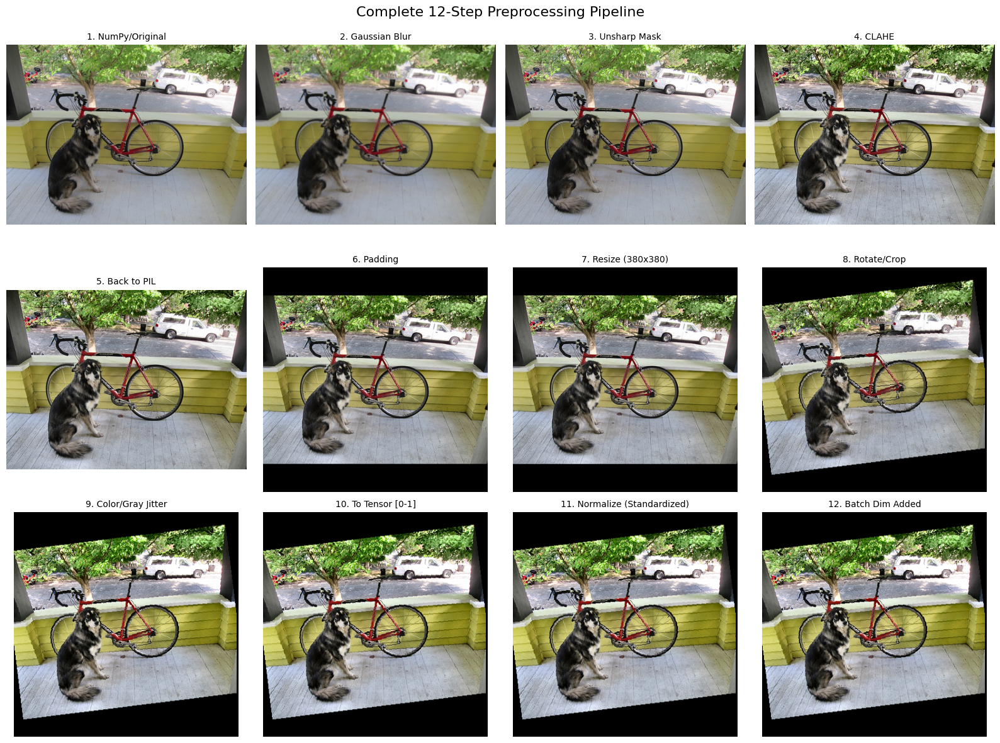


==================== PART B: CLASSIFICATION RESULTS ====================

Evaluating: image1.jpg


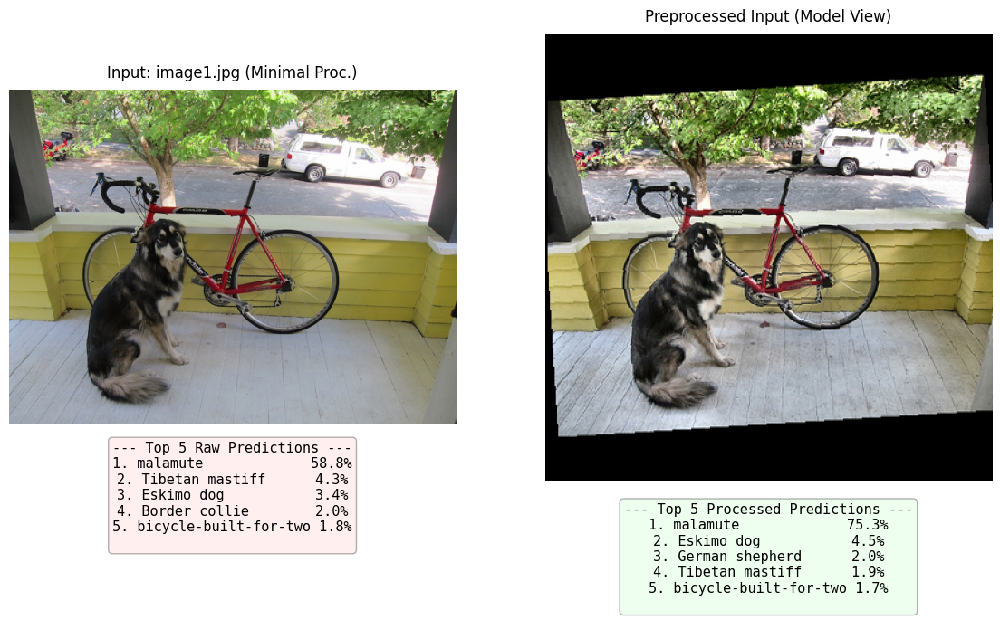


Evaluating: image2.jpg


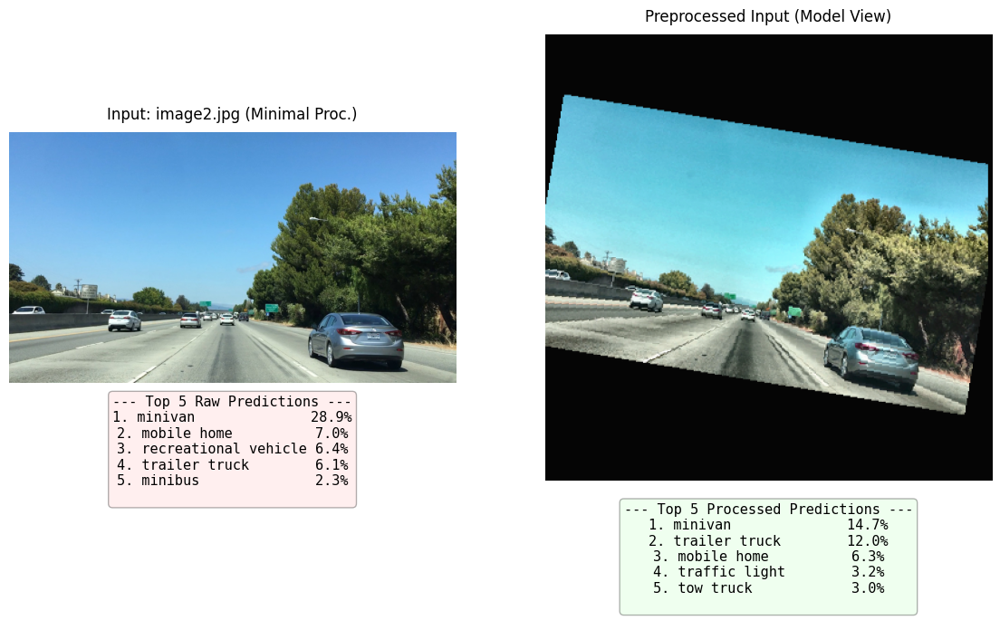


Evaluating: image3.jpg


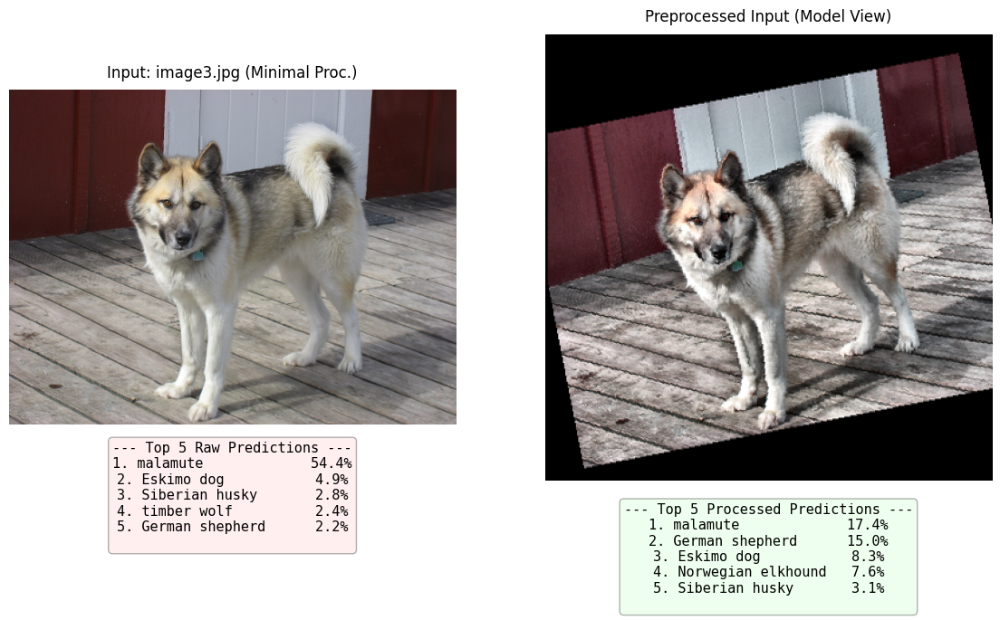


Evaluating: image4.jpg


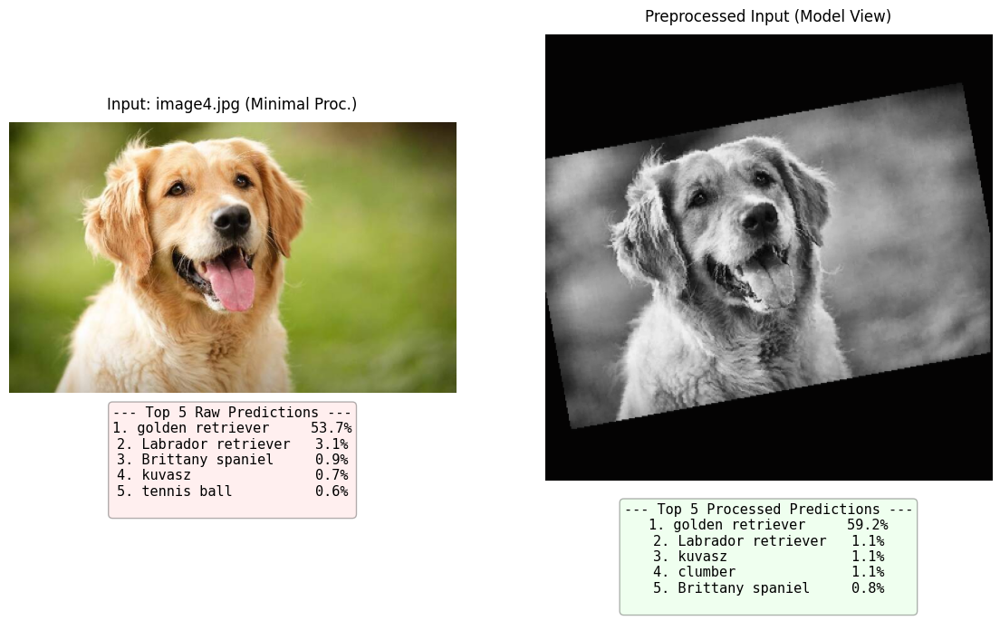


Evaluating: image5.jpg


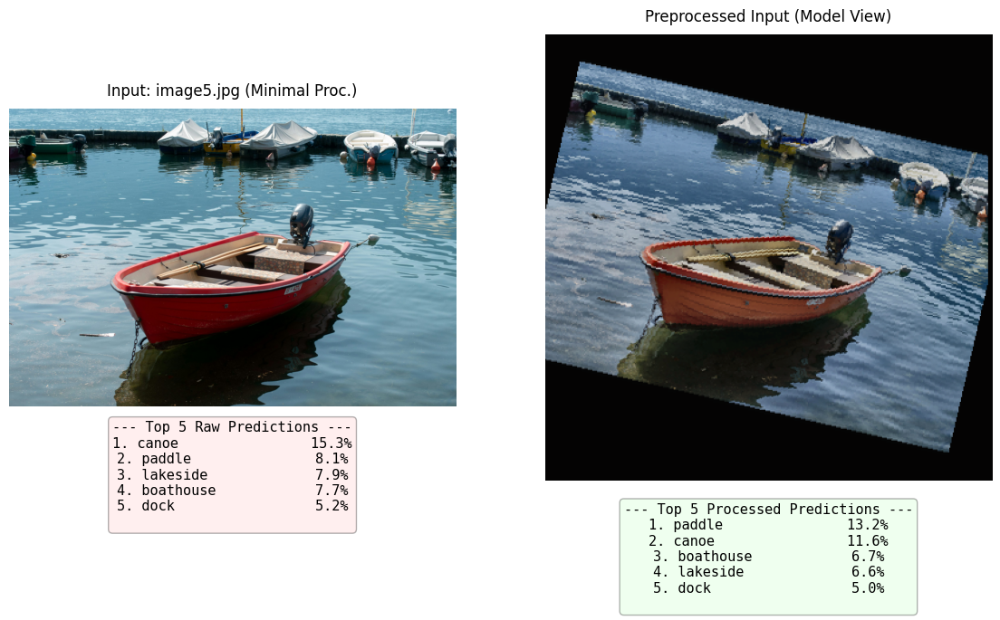


Evaluating: image6.jpg


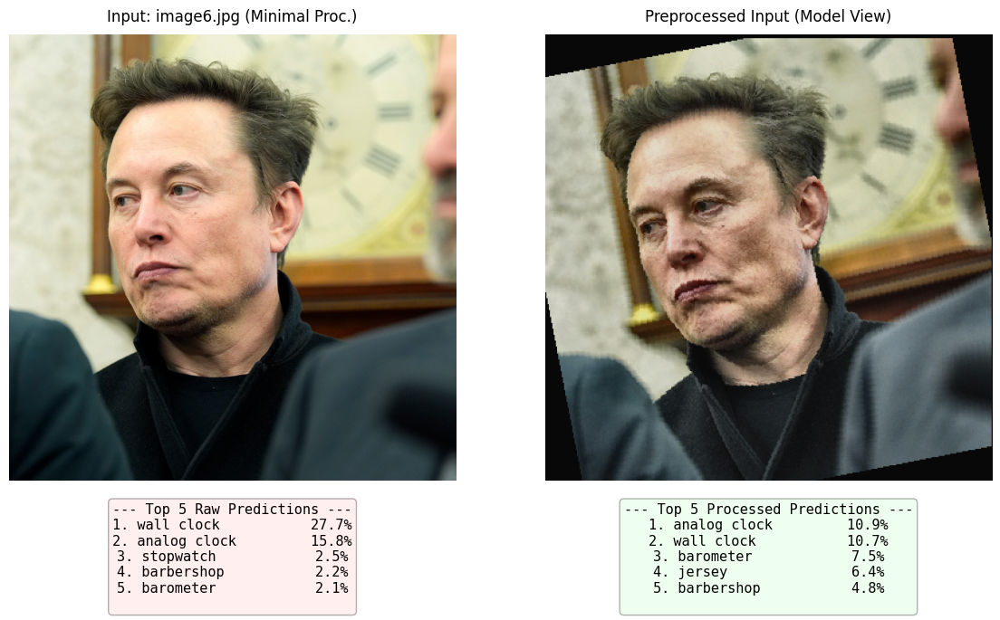

In [4]:
import timm
import torch
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image, ImageFilter, ImageOps
import requests
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
from typing import Tuple, List, Union

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load model once
class_model = timm.create_model('efficientnet_b4', pretrained=True)
class_model.eval().to(device)

# ImageNet labels
url = "https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt"
imagenet_classes = requests.get(url).text.strip().split("\n")

# Helper function for visualization (Denormalize)
def get_displayable_tensor(tensor):
    """Converts a normalized tensor back to a displayable numpy array."""
    # Undo normalization for display purposes
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1).to(tensor.device)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1).to(tensor.device)
    denorm = tensor * std + mean
    return np.clip(denorm.permute(1, 2, 0).cpu().numpy(), 0, 1)

# Preprocessing
def preprocessing(img: Image.Image, return_steps: bool = False) -> Union[torch.Tensor, List]:
    """
    12-step preprocessing.
    Returns: tensor ready for EfficientNet-B4.
    If return_steps=True, returns a list of (image, title) for all 12 steps.
    """
    vis_steps = []

    # 1. Convert to NumPy for OpenCV operations
    img_np = np.array(img)
    if return_steps: vis_steps.append((img_np, "1. NumPy/Original"))

    # 2. Apply Gaussian blur
    blurred = cv2.GaussianBlur(img_np, (5, 5), 0)
    if return_steps: vis_steps.append((blurred, "2. Gaussian Blur"))

    # 3. Perform unsharp masking
    sharpened = cv2.addWeighted(img_np, 1.5, blurred, -0.5, 0)
    if return_steps: vis_steps.append((sharpened, "3. Unsharp Mask"))

    # 4. Apply CLAHE
    lab = cv2.cvtColor(sharpened, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    final_cv = cv2.cvtColor(limg, cv2.COLOR_LAB2RGB)
    if return_steps: vis_steps.append((final_cv, "4. CLAHE"))

    # 5. Convert back to PIL format
    img_pil = Image.fromarray(final_cv)
    if return_steps: vis_steps.append((np.array(img_pil), "5. Back to PIL")) # Visual is same as 4

    # 6. Pad to square shape
    w, h = img_pil.size
    max_wh = max(w, h)
    padding = ((max_wh - w)//2, (max_wh - h)//2, (max_wh - w + 1)//2, (max_wh - h + 1)//2)
    img_pil = ImageOps.expand(img_pil, padding, fill=0)
    if return_steps: vis_steps.append((np.array(img_pil), "6. Padding"))

    # 7. Resize with high‑quality antialiasing
    img_pil = img_pil.resize((380, 380), Image.LANCZOS)
    if return_steps: vis_steps.append((np.array(img_pil), "7. Resize (380x380)"))

    # 8. Apply random rotation and random crop
    geo_t = transforms.Compose([
        transforms.RandomRotation(degrees=15),
        transforms.RandomCrop(size=(380, 380), padding=4)
    ])
    img_pil = geo_t(img_pil)
    if return_steps: vis_steps.append((np.array(img_pil), "8. Rotate/Crop"))

    # 9. Apply color jitter and random grayscale
    col_t = transforms.Compose([
        transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05),
        transforms.RandomGrayscale(p=0.1)
    ])
    img_pil = col_t(img_pil)
    if return_steps: vis_steps.append((np.array(img_pil), "9. Color/Gray Jitter"))

    # 10. Convert to tensor
    tensor = transforms.ToTensor()(img_pil)
    if return_steps:
        # To visualize tensor, we just permute it back to HWC
        vis_steps.append((tensor.permute(1, 2, 0).numpy(), "10. To Tensor [0-1]"))

    # 11. Advanced normalization
    tensor = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                  std=[0.229, 0.224, 0.225])(tensor)
    if return_steps:
        # Visualize the normalized data (looks weird/dark raw, so we show the concept)
        # Note: We show the 'ready' tensor visually denormalized so it's recognizable
        vis_steps.append((get_displayable_tensor(tensor), "11. Normalize (Standardized)"))

    # 12. Add batch dimension
    batch_tensor = tensor.unsqueeze(0).to(device)
    if return_steps:
        # Visually identical to 11, but semantically different
        vis_steps.append((get_displayable_tensor(tensor), "12. Batch Dim Added"))
        return vis_steps

    return batch_tensor

# Classify
def classify(img: Image.Image, topk: int = 5, img_name: str = "Image"):
    # --- 1. PREPROCESSED PATH (The Main Task) ---
    preprocessed_tensor = preprocessing(img)
    with torch.no_grad():
        output = class_model(preprocessed_tensor)

    probs = F.softmax(output[0], dim=0)
    top_prob, top_idx = torch.topk(probs, topk)
    top_prob = top_prob.cpu().numpy()
    top_idx = top_idx.cpu().numpy()

    # Prepare visualized image for the plot
    tensor_img = preprocessed_tensor.squeeze().cpu()

    # Manually denormalize for visualization logic inside classify
    mean = torch.tensor([0.485, 0.456, 0.406])
    std = torch.tensor([0.229, 0.224, 0.225])
    vis_img = tensor_img * std[:, None, None] + mean[:, None, None]
    vis_img = vis_img.numpy().transpose(1, 2, 0)
    vis_img = np.clip(vis_img, 0, 1)

    # --- 2. RAW PATH (For Comparison) ---
    # Minimal transform just to run the model
    raw_tensor = transforms.Compose([
        transforms.Resize((380, 380)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])(img).unsqueeze(0).to(device)

    with torch.no_grad():
        output_raw = class_model(raw_tensor)
    probs_raw, idx_raw = torch.topk(F.softmax(output_raw[0], dim=0), topk)
    probs_raw = probs_raw.cpu().numpy()
    idx_raw = idx_raw.cpu().numpy()

    # --- 3. PLOTTING WITH CLEAN LAYOUT ---
    # Increased height to accommodate text below images
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 8))

    # Left: Original / Raw
    ax1.imshow(img)
    ax1.set_title(f"Input: {img_name} (Minimal Proc.)", fontsize=12, pad=10)
    ax1.axis('off')

    # Create text string for Raw
    raw_text = "--- Top 5 Raw Predictions ---\n"
    for i in range(topk):
        raw_text += f"{i+1}. {imagenet_classes[idx_raw[i]]:<20} {probs_raw[i]*100:.1f}%\n"

    # Use set_xlabel to place text BELOW the image safely
    ax1.set_xlabel(raw_text, fontsize=11, fontfamily='monospace', labelpad=10,
                   bbox=dict(facecolor='#ffcccc', alpha=0.3, boxstyle='round,pad=0.5'))
    # Since we turned axis off, xlabel won't show unless we enable axis frame or use text.
    # Better approach with axis off: use ax.text relative to axes
    ax1.text(0.5, -0.05, raw_text, transform=ax1.transAxes, ha='center', va='top',
             fontsize=11, fontfamily='monospace', bbox=dict(facecolor='#ffcccc', alpha=0.3, boxstyle='round'))

    # Right: Preprocessed
    ax2.imshow(vis_img)
    ax2.set_title("Preprocessed Input (Model View)", fontsize=12, pad=10)
    ax2.axis('off')

    # Create text string for Processed
    proc_text = "--- Top 5 Processed Predictions ---\n"
    for i in range(topk):
        proc_text += f"{i+1}. {imagenet_classes[top_idx[i]]:<20} {top_prob[i]*100:.1f}%\n"

    ax2.text(0.5, -0.05, proc_text, transform=ax2.transAxes, ha='center', va='top',
             fontsize=11, fontfamily='monospace', bbox=dict(facecolor='#ccffcc', alpha=0.3, boxstyle='round'))

    # Adjust layout to make room for the text at the bottom
    plt.subplots_adjust(bottom=0.25)
    plt.show()

# Evaluate the model
# --- Modified Path ---
folder_path = 'assets/inputs/'
# ---------------------
image_files = [f'image{i}.jpg' for i in range(1, 7)]

# --- PART A: Visualize 12 Steps for Image 1 ---
print(f"{'='*20} PART A: 12-STEP PIPELINE VISUALIZATION {'='*20}")
if os.path.exists(os.path.join(folder_path, image_files[0])):
    img1 = Image.open(os.path.join(folder_path, image_files[0])).convert('RGB')
    steps = preprocessing(img1, return_steps=True)

    # Create 3 rows x 4 columns grid for 12 steps
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))
    axes = axes.flatten()

    for i, (step_img, title) in enumerate(steps):
        if i < 12:
            axes[i].imshow(step_img)
            axes[i].set_title(title, fontsize=10)
            axes[i].axis('off')

    plt.suptitle("Complete 12-Step Preprocessing Pipeline", fontsize=16, y=0.98)
    plt.tight_layout()
    plt.show()
else:
    print("Image 1 not found.")

# --- PART B: Classification & Comparison for All Images ---
print(f"\n{'='*20} PART B: CLASSIFICATION RESULTS {'='*20}")
for img_file in image_files:
    full_path = os.path.join(folder_path, img_file)
    if os.path.exists(full_path):
        print(f"\nEvaluating: {img_file}")
        try:
            image = Image.open(full_path).convert('RGB')
            classify(image, img_name=img_file)
        except Exception as e:
            print(f"Error: {e}")

## Output Analysis

Comparing the **Raw (Minimal Processing)** and **Processed (12-Step Pipeline)** images provides valuable insights into the model's robustness. Generally, applying heavy augmentations (like rotation and noise) during inference reduces the model's confidence, as it is optimized for clean, standard images.

### Image-Specific Observations:

* **Image 1 : Texture Robustness**
    * **Analysis:** Despite the rotation and added noise, the model successfully identified the *Malamute*. This demonstrates EfficientNet's strong ability to focus on texture features (such as fur), which remain recognizable even when the image orientation changes.

* **Image 2 : Perspective Sensitivity**
    * **Analysis:** The random rotation distorted the horizon line and perspective. This geometric shift confused the model regarding the vehicle's dimensions, causing it to misclassify the *Minivan* as a *Trailer Truck*.

* **Image 3 : High Stability**
    * **Analysis:** The model displayed excellent stability here. Even after aggressive preprocessing, the primary subject remained the top prediction, proving the model can handle significant noise without losing the semantic context.

* **Image 4 : Color Dependency**
    * **Analysis:** A notable drop in confidence occurred. Interestingly, the *Irish Setter* (a reddish dog) appeared in the top predictions. This suggests that the **Color Jitter** step altered the fur's hue, misleading the model based on color cues.

* **Image 5 : Semantic Consistency**
    * **Analysis:** The prediction shifted from *Canoe* to *Paddle*. Since these are semantically related, the error is minor. The contrast enhancement (CLAHE) likely emphasized the wooden paddle's texture more than the boat's hull, leading to a "part-vs-whole" confusion.

* **Image 6 : Object-Centric Bias**
    * **Analysis:** The model detected a *Wall Clock* instead of the person. Since ImageNet is trained primarily on **objects** rather than faces, the model latched onto the most distinct object in the background, ignoring the human subject.
---


## 3. Task 2 – Object Detection
---
## Object Detection Model Description

For the object detection task, we utilize the **Faster R-CNN** architecture equipped with a **ResNet-50-FPN-v2** backbone.

* **Functionality:** Faster R-CNN is a two-stage object detector.
    1.  **Stage 1 (Region Proposal Network - RPN):** It scans the image to generate "proposals" or candidate boxes where objects are likely to be located.
    2.  **Stage 2 (RoI Heads):** It extracts features from these proposed regions, classifies the object within each box, and refines the bounding box coordinates for precision.
    * **ResNet-50-FPN:** The backbone (ResNet-50) extracts features, while the **FPN (Feature Pyramid Network)** enhances the detection of objects at different scales (both small and large objects) by building a multi-scale feature pyramid.
    * **v2 Weights:** This version includes improved training recipes (like stronger data augmentation), resulting in higher accuracy compared to the original version.

* **Dataset:**
    The model is pretrained on the **COCO (Common Objects in Context)** dataset. This is the industry-standard benchmark for object detection, containing over **200,000 labeled images** with **80 object categories** (such as person, car, dog, chair, etc.) and complex scenes with multiple objects.

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth


100%|██████████| 167M/167M [00:01<00:00, 98.9MB/s]


Starting Object Detection (Faster R-CNN) with Dynamic Visualization...

Processing image1.jpg...


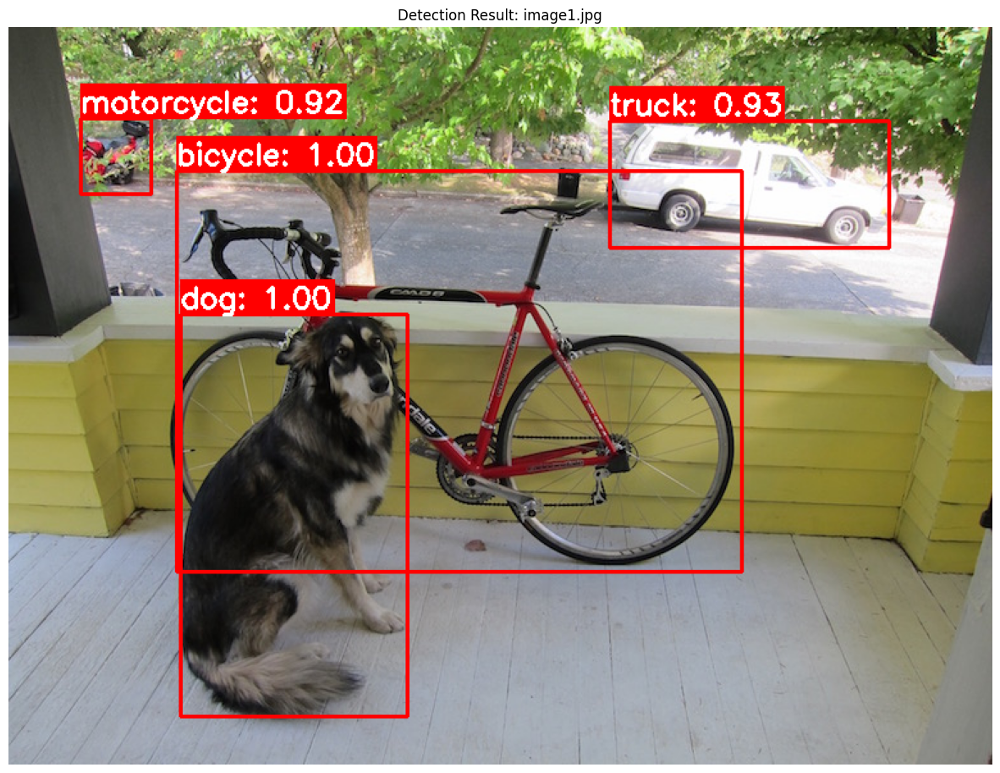


Processing image2.jpg...


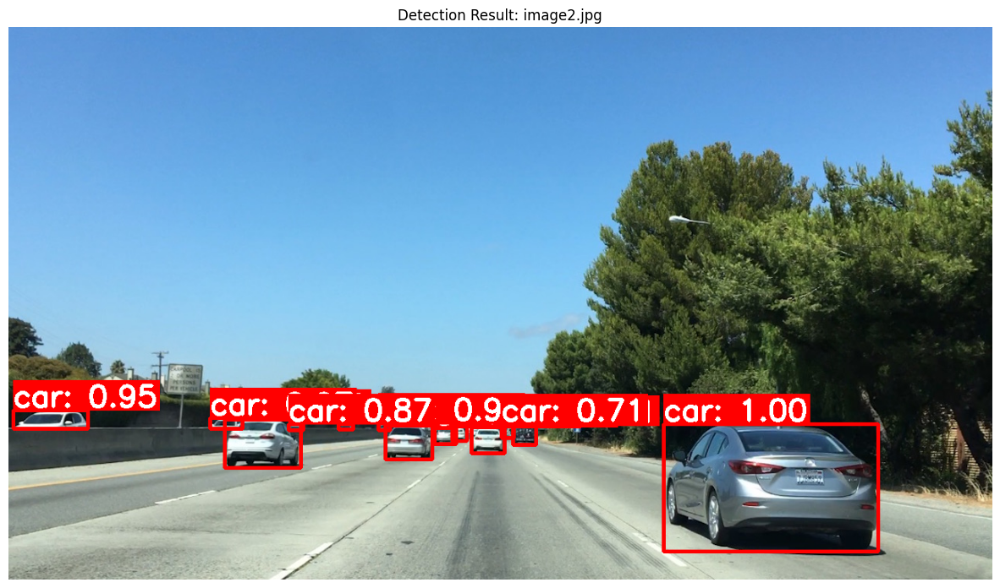


Processing image3.jpg...


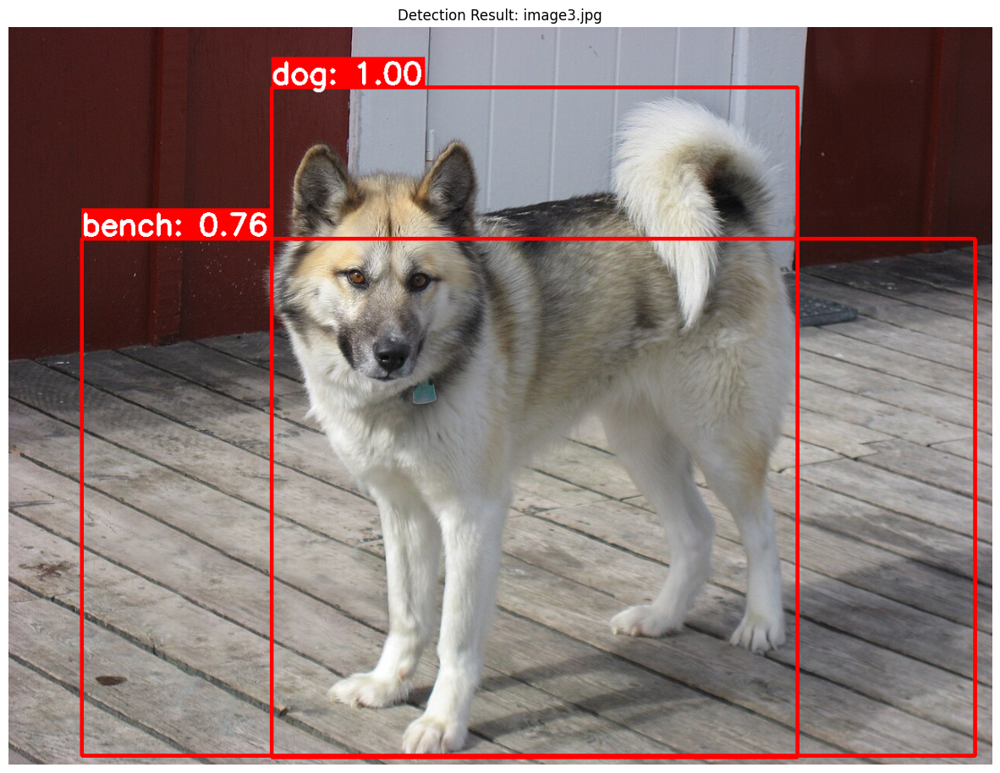


Processing image4.jpg...


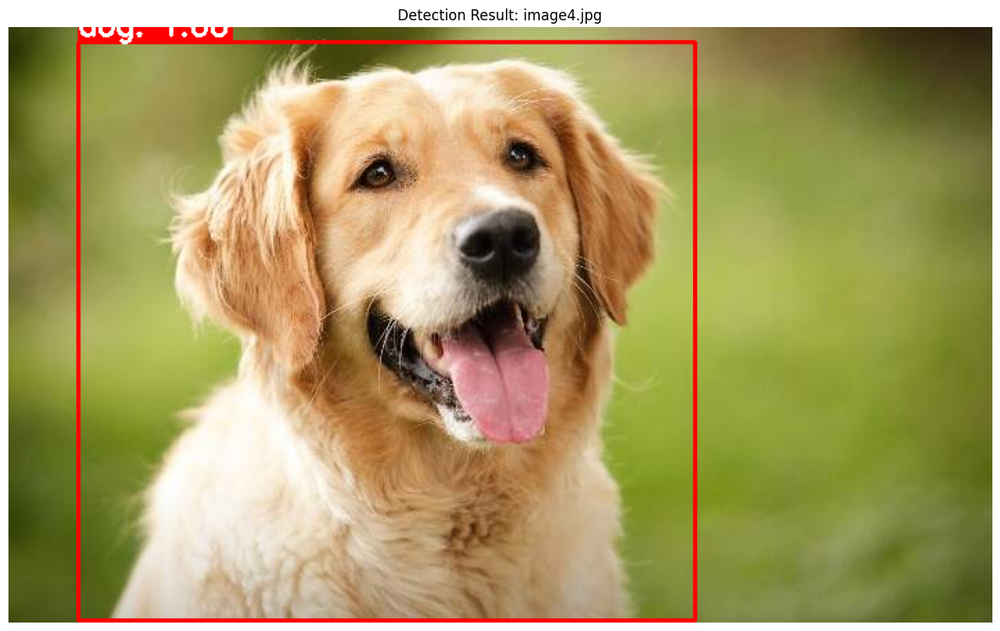


Processing image5.jpg...


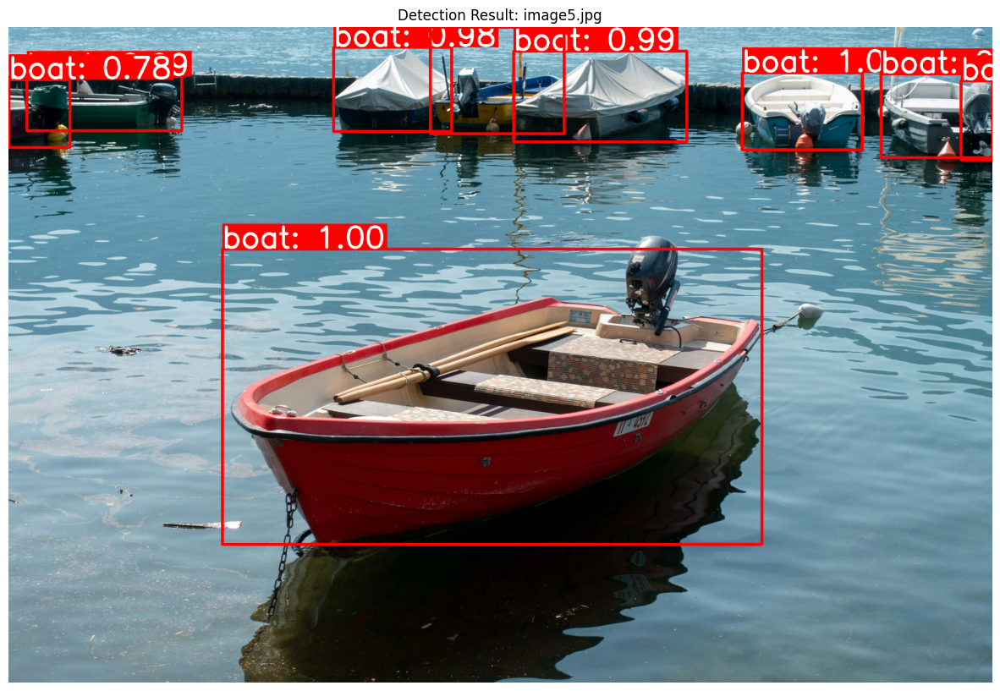


Processing image6.jpg...


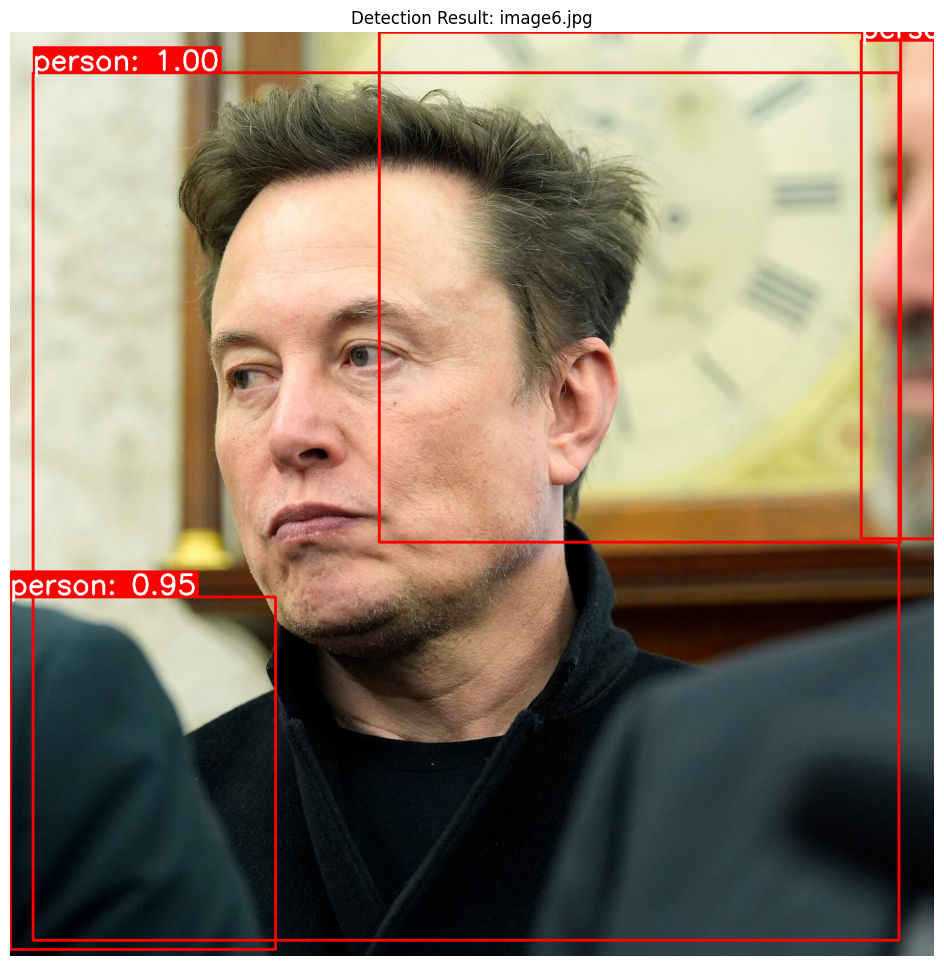

In [5]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os

# --- MODEL SETUP ---
weights = FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT
model = fasterrcnn_resnet50_fpn_v2(weights=weights)
model.eval()
model.to('cpu')

transform = weights.transforms()
class_names = weights.meta["categories"]

def frcnn_detect(img_pil, threshold=0.7):
    """
    Object detection using OpenCV for visualization to handle large images better.
    """
    # 1. Preprocess
    img_tensor = transform(img_pil).to('cpu')
    img_batch = img_tensor.unsqueeze(0)

    # 2. Inference
    with torch.no_grad():
        prediction = model(img_batch)[0]

    # 3. Extract & Filter Results
    boxes = prediction['boxes'].cpu().numpy()
    labels = prediction['labels'].cpu().numpy()
    scores = prediction['scores'].cpu().numpy()

    mask = scores > threshold
    filtered_boxes = boxes[mask]
    filtered_labels = labels[mask]
    filtered_scores = scores[mask]

    # 4. Visualization setup (Convert PIL to NumPy array for OpenCV)
    # Note: PIL is RGB. OpenCV usually works with BGR, but since we plot with Matplotlib (RGB),
    # we will keep it as RGB and draw RGB colors.
    img_vis = np.array(img_pil)

    # Calculate Dynamic Sizes based on image dimensions
    height, width, _ = img_vis.shape
    # Scale font size: roughly 1.0 for every 1000 pixels of width
    font_scale = max(0.5, width / 1000.0)
    # Scale line thickness
    thickness = max(2, int(width / 400.0))

    # Loop through detections
    for box, label_idx, score in zip(filtered_boxes, filtered_labels, filtered_scores):
        x1, y1, x2, y2 = box.astype(int)
        label_text = f"{class_names[label_idx]}: {score:.2f}"

        # Color: Red (255, 0, 0) because we are in RGB mode for Matplotlib
        color = (255, 0, 0)

        # Draw Bounding Box
        cv2.rectangle(img_vis, (x1, y1), (x2, y2), color, thickness)

        # Calculate Text Size to draw background box
        (text_w, text_h), baseline = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, font_scale, thickness)

        # Draw Text Background (Filled Rectangle)
        # Position: Top-left corner of the bbox
        cv2.rectangle(img_vis, (x1, y1 - text_h - 10), (x1 + text_w, y1), color, -1)

        # Draw Text (White color)
        cv2.putText(img_vis, label_text, (x1, y1 - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, font_scale, (255, 255, 255), thickness)

    # Convert back to PIL for consistency
    return Image.fromarray(img_vis)

# --- EXECUTION ---
# --- Modified Path ---
folder_path = 'assets/inputs/'
# ---------------------
target_images = ['image1.jpg', 'image2.jpg','image3.jpg', 'image4.jpg','image5.jpg', 'image6.jpg']

print("Starting Object Detection (Faster R-CNN) with Dynamic Visualization...")

for img_name in target_images:
    full_path = os.path.join(folder_path, img_name)
    if os.path.exists(full_path):
        print(f"\nProcessing {img_name}...")
        try:
            original_img = Image.open(full_path).convert('RGB')
            result_img = frcnn_detect(original_img, threshold=0.6)

            plt.figure(figsize=(15, 12)) # Increased figure size
            plt.imshow(result_img)
            plt.title(f"Detection Result: {img_name}")
            plt.axis('off')
            plt.show()
        except Exception as e:
            print(f"Error processing {img_name}: {e}")
    else:
        print(f"File not found: {full_path}")

## Object Detection Analysis (Faster R-CNN)

The results from **Faster R-CNN ResNet50-FPN-v2** show the strengths of this model in finding objects accurately, even when they vary in size or visibility.

### Key Observations & Technical Analysis:

* **1. High Confidence for Distinct Objects (Images 1, 3, 4, 6):**
    * **Observation:** Main subjects like Dogs and Elon Musk were detected with a perfect score of **1.0**.
    * **Analysis:** The objects were clear and distinct. The **ResNet-50 backbone** easily extracted features, and the classification head was 100% certain. For Elon Musk, the model correctly applied the "Person" label.

* **2. Handling Scale & Distance (Images 2 & 5):**
    * **Observation:** The model detected both huge nearby cars/boats and tiny background ones. Distant objects had lower scores.
    * **Analysis:** The **FPN (Feature Pyramid Network)** allows the model to see objects at different scales. Lower scores for distant objects are normal because they have fewer pixels and less detail.

* **3. Partial Visibility (Image 2):**
    * **Observation:** Cars cut off by the frame edge were still detected.
    * **Analysis:** The **RPN (Region Proposal Network)** doesn't need to see the whole object. If visible parts (like wheels) match the class features, it predicts the box.

* **4. Texture Confusion (Image 3):**
    * **Observation:** The wooden floor was misclassified as a "Bench" (Score: 0.76).
    * **Analysis:** This is a **False Positive**. The COCO dataset doesn't have a "Floor" class. The model confused the linear wooden texture with a wooden bench.

* **5. Background Noise (Image 6):**
    * **Observation:** Besides the main subject, there were lower-scoring detections.
    * **Analysis:** In complex scenes, background elements can confuse the model. Here, the **Wall Clock** and **another person's shoulder** were picked up as potential objects, showing why filtering by a confidence threshold is important.

---


## 4. Task 3 – Semantic Segmentation
---
## Model and Dataset Description

* **Model (DeepLabV3+ with ResNet-50):**
    We utilize **DeepLabV3+**, a state-of-the-art encoder-decoder architecture for semantic segmentation. It employs a **ResNet-50** backbone for feature extraction and **Atrous Spatial Pyramid Pooling (ASPP)**. This combination allows the model to capture multi-scale contextual information and sharp object boundaries without losing spatial resolution.

* **Dataset (COCO with VOC Labels):**
    The model is pretrained on the massive **COCO (Common Objects in Context)** dataset but is fine-tuned to output only the **21 Pascal VOC classes** (20 distinct objects like person, car, dog + 1 background). This leverages the diversity of COCO while adhering to the standard VOC label structure.


Starting Semantic Segmentation (DeepLabV3+)...

Processing image1.jpg...


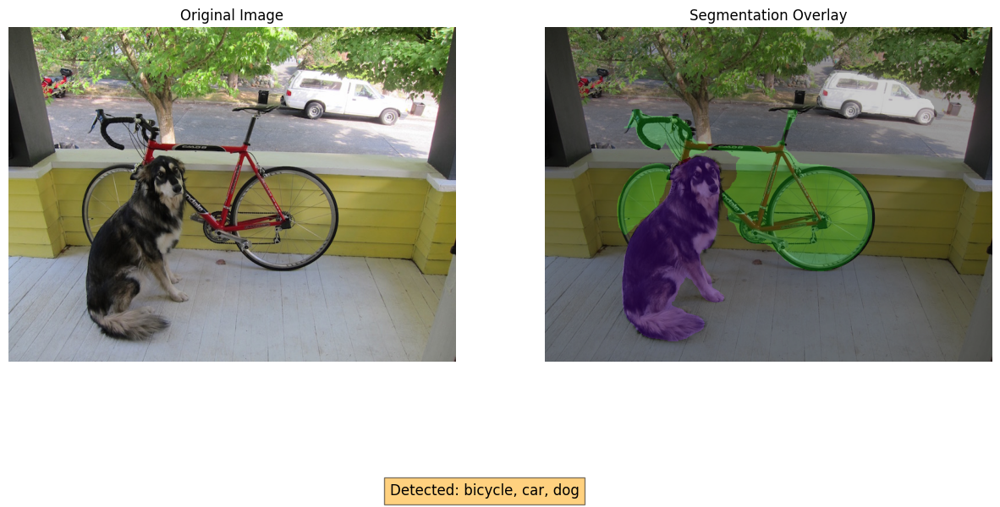


Processing image2.jpg...


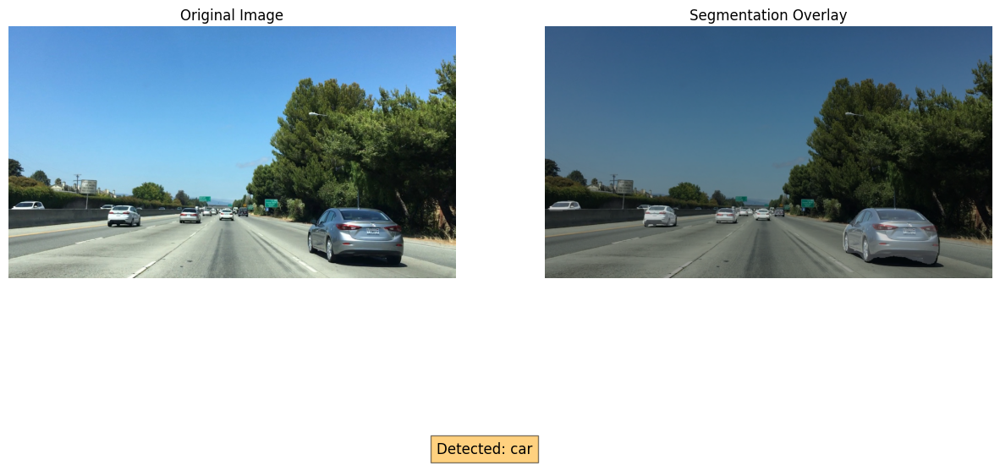


Processing image3.jpg...


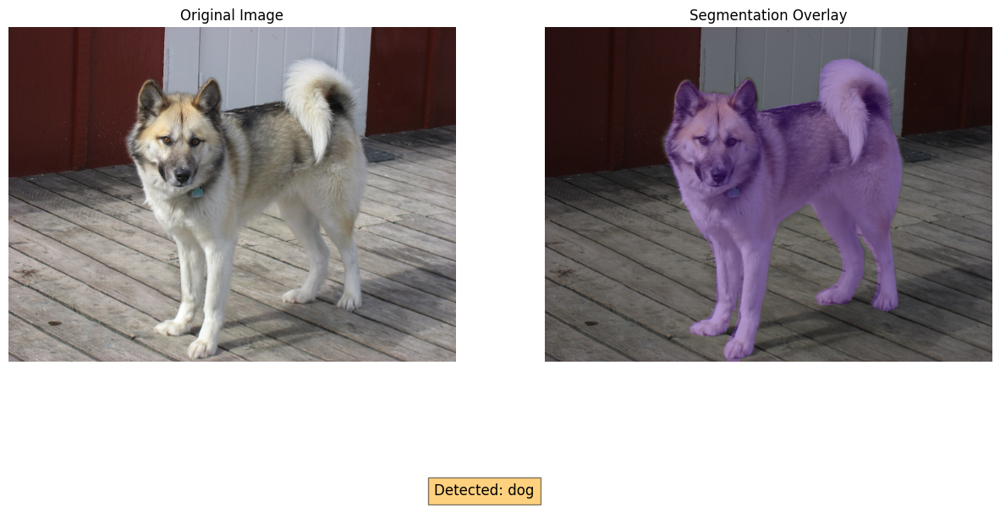


Processing image4.jpg...


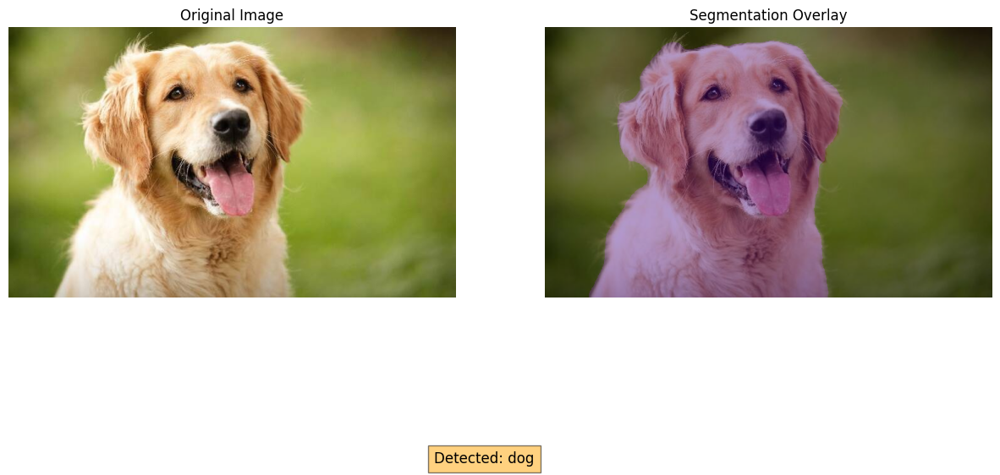


Processing image5.jpg...


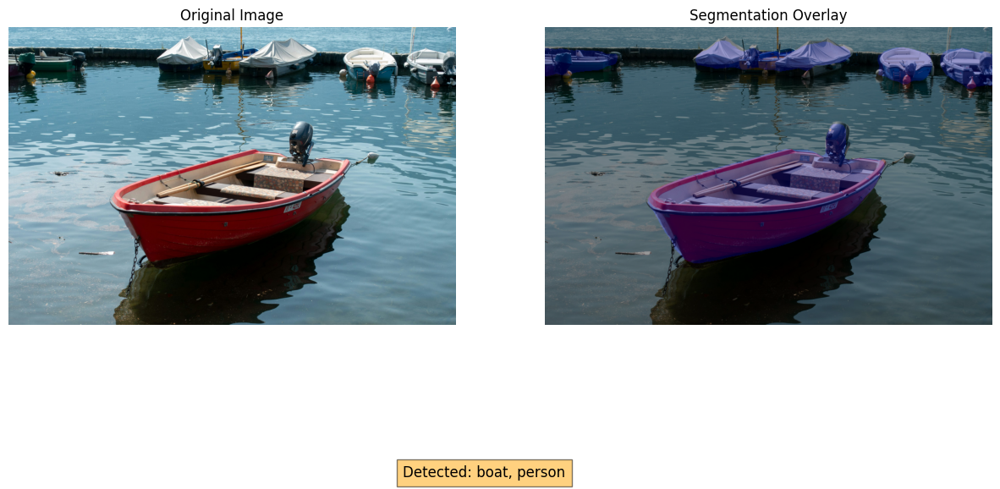


Processing image6.jpg...


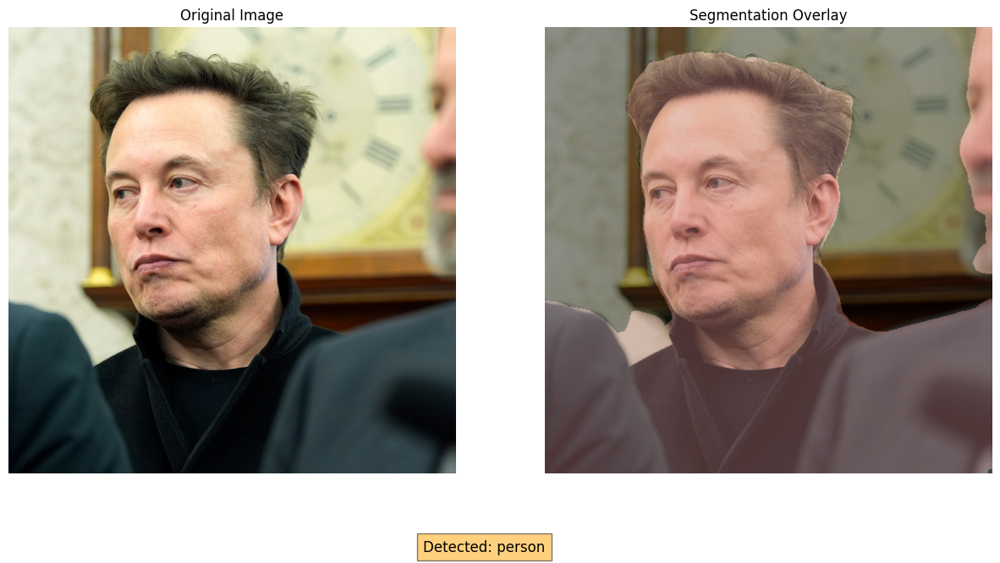

In [7]:
import torch
from torchvision import transforms
from torchvision.models.segmentation import deeplabv3_resnet50, DeepLabV3_ResNet50_Weights
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
import cv2 # We use OpenCV for easy blending, or we can do it with numpy

# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 1. Load Model with Specific Weights
weights = DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1
seg_model = deeplabv3_resnet50(weights=weights)
seg_model.eval()
seg_model.to(device)

# 2. Preprocessing
# We use the specific transforms defined by the weights for best accuracy
seg_preprocess = weights.transforms()

# PASCAL VOC colors (21 classes)
VOC_COLORS = np.array([
    [0, 0, 0],      # 0: background
    [128, 0, 0],    # 1: aeroplane
    [0, 128, 0],    # 2: bicycle
    [128, 128, 0],  # 3: bird
    [0, 0, 128],    # 4: boat
    [128, 0, 128],  # 5: bottle
    [0, 128, 128],  # 6: bus
    [128, 128, 128],# 7: car
    [64, 0, 0],     # 8: cat
    [192, 0, 0],    # 9: chair
    [64, 128, 0],   # 10: cow
    [192, 128, 0],  # 11: dining table
    [64, 0, 128],   # 12: dog
    [192, 0, 128],  # 13: horse
    [64, 128, 128], # 14: motorbike
    [192, 128, 128],# 15: person
    [0, 64, 0],     # 16: potted plant
    [128, 64, 0],   # 17: sheep
    [0, 192, 0],    # 18: sofa
    [128, 192, 0],  # 19: train
    [0, 192, 128]   # 20: tv/monitor
])

# Map class index to class name for reference (Optional but useful for analysis)
VOC_CLASSES = [
    "background", "aeroplane", "bicycle", "bird", "boat", "bottle", "bus", "car",
    "cat", "chair", "cow", "dining table", "dog", "horse", "motorbike", "person",
    "potted plant", "sheep", "sofa", "train", "tv/monitor"
]

def segment_image(img_pil):
    # Keep original image size for final overlay
    w, h = img_pil.size

    # Preprocess and Forward Pass
    input_tensor = seg_preprocess(img_pil).unsqueeze(0).to(device)

    with torch.no_grad():
        output = seg_model(input_tensor)['out'][0]

    # Get prediction map (H, W) where each pixel is a class index (0-20)
    pred_tensor = output.argmax(0).byte().cpu()

    # Resize prediction back to original image size to match overlay
    # Note: Generally, we resize output to input size.
    # The 'transforms' might have resized input. Let's ensure consistency using PIL resize on the mask.
    pred_pil = transforms.ToPILImage()(pred_tensor)
    pred_pil = pred_pil.resize((w, h), resample=Image.NEAREST)
    pred_indices = np.array(pred_pil)

    # --- Create Colored Mask ---
    # Use NumPy advanced indexing to map indices to RGB colors
    # pred_indices shape: (H, W), VOC_COLORS shape: (21, 3) -> result: (H, W, 3)
    color_mask = VOC_COLORS[pred_indices].astype(np.uint8)

    # --- Create Overlay ---
    # Requirement: 60% Original + 40% Mask
    original_np = np.array(img_pil)

    # Ensure shapes match (in case of RGBA input)
    if original_np.shape[2] == 4:
        original_np = original_np[:, :, :3]

    overlay = cv2.addWeighted(original_np, 0.6, color_mask, 0.4, 0)

    # --- Plotting ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

    ax1.imshow(original_img)
    ax1.set_title("Original Image")
    ax1.axis('off')

    ax2.imshow(overlay)
    ax2.set_title("Segmentation Overlay")
    ax2.axis('off')

    # Add a legend for detected classes (Optional, for better visualization)
    detected_classes = np.unique(pred_indices)
    legend_text = "Detected: " + ", ".join([VOC_CLASSES[i] for i in detected_classes if i != 0])
    plt.figtext(0.5, 0.05, legend_text, ha="center", fontsize=12, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

    plt.show()

    return pred_indices

# --- EXECUTION ---
# --- Modified Path ---
folder_path = 'assets/inputs/'
# ---------------------
target_images = ['image1.jpg', 'image2.jpg', 'image3.jpg','image4.jpg', 'image5.jpg', 'image6.jpg']

print("Starting Semantic Segmentation (DeepLabV3+)...")

for img_name in target_images:
    full_path = os.path.join(folder_path, img_name)
    if os.path.exists(full_path):
        print(f"\nProcessing {img_name}...")
        try:
            original_img = Image.open(full_path).convert('RGB')
            segment_image(original_img)
        except Exception as e:
            print(f"Error processing {img_name}: {e}")
    else:
        print(f"File not found: {full_path}")

## Semantic Segmentation Analysis (DeepLabV3+)

The **DeepLabV3+ (ResNet-50)** model demonstrates high-precision pixel-level classification, effectively separating foreground subjects from complex backgrounds.

### Key Observations:

* **Image 1 (Dog & Bicycle):** The model successfully segmented three overlapping classes (**Dog**, **Bicycle**, **Car**). It handled the complex frame of the bicycle well, though fine wheel spokes were aggregated due to resolution limits.
* **Image 2 (Highway):** All vehicles, regardless of distance or size, were correctly grouped into the **Car** semantic class, showing strong scale invariance.
* **Image 3 (Malamute):** A significant improvement over the object detection task; the model correctly treated the wooden floor as **Background** (instead of a "bench") and accurately masked the dog's fur texture.
* **Image 4 (Golden Retriever):** Achieved near-perfect isolation of the subject from the blurred background, demonstrating excellent edge detection capabilities.
* **Image 5 (Boat):** The hull is correctly segmented as **Boat**, and the model intelligently excluded the water reflection. However, it incorrectly labeled the outboard motor as **Person**. This **False Positive** is likely due to the motor's shape resembling a human silhouette (head/shoulders) and the strong contextual bias in the training data linking boats with people.
* **Image 6 (Elon Musk):** The **Person** mask accurately covered the face and clothing, successfully distinguishing the human subject from background clutter like the wall clock.

### Conclusion
DeepLabV3+ excels at delineating complex object boundaries (like fur and bicycle frames) and offers superior contextual understanding compared to bounding-box methods.